### TITLE        : Predicting Aqueous Solubility of Organic Molecules Using Light Gradient Boosting Machine (209 Molecular Descriptors Versus Avalon Fingerprint as Molecular Features).
### AUTHORS   : Comfort M. Ngwu Ph.D, Daniel C. Ottah and Gabriel  I. Nwabeke
### DATE        :  21st-April-2024

## Brief summary: 
Aqueous solubility is one of the major key factors that affects the oral bioavailability of drugs, and its prediction remains a crucial challenge owing to the lack of reliable and reproducible measurements alongside the time and cost of experimental approaches. Because of its apparent necessity in numerous pharmaceutical, environmental, agrochemical, and energy storage applications, a lot of effort has been put into developing reliable and robust machine-learning aqueous solubility models. Aqueous Solubility, a crucial concept, is defined as the maximum quantity of solute capable of dissolving in a specific volume of water to produce a saturated solution at a designated temperature—typically room temperature. A fundamental guiding principle is "like dissolves like," signifying that molecules sharing similar polarities and intermolecular forces exhibit a greater tendency to dissolve in one another.The significance of water solubility extends into the realm of drug discovery, directly impacting bioavailability. Bioavailability, the measure of a drug's absorption and its ability to reach the intended target site, hinges on the solubility characteristics of the compound. Notably, the execution of a biological assay becomes impractical if a compound fails to dissolve effectively in water.Recognizing this connection, our approach employs two different molecular features (209 molecular descriptors and Avalon fingerprint) independently for for each machine learning model.

 STEPS:  
1.	ASK (Define the problem) 
2.	Data preparation
3.	Data processing & Generation of molecular features
4.	Select Machine Learning Models 
5.	Fine-tune the Selected Model 
6.  Use the Optimal Model for Test data
7.  Save the Trained Model and Standard Scaler for New Data



### STEP 1: Problem Definition
##### Here we want to evaluate the impact of molecular descriptors and Avalon fingerprint in predicting the aqueous solubility of organic compounds.

##### 1.1: Importing the required libraries

In [1]:
import warnings
warnings.filterwarnings("ignore")
#--------------------------------
import pandas as pd
import numpy as np
#--------------------------------
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
#-----------------------------
import rdkit 
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.DataStructs.cDataStructs import ExplicitBitVect
from rdkit.Avalon import pyAvalonTools
from rdkit.Chem import PandasTools
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import Descriptors
from rdkit.ML.Descriptors import MoleculeDescriptors
#-------------------------------
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ShuffleSplit, cross_validate,train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error,mean_squared_error

import lightgbm as lgb
from lightgbm import LGBMRegressor
#--------------------------------
#import lazypredict
#from lazypredict.Supervised import LazyRegressor, LazyClassifier
#--------------------------------
import tqdm
from tqdm import tqdm
import time
#--------------------------------
import warnings
warnings.filterwarnings("ignore")
%pwd
#--------------------------------

'c:\\Documents\\BIOINFORMATICS PROJECTS\\aqueous_solubility'

### STEP 2: Data preparation
#### Here we ensure that the data is clean

##### 2.1: Importing datasets

In [2]:
#Importing the AqSol dataset.
df = pd.read_csv(r"C:\Documents\BIOINFORMATICS PROJECTS\aqueous_solubility\AqSol dataset.csv")
df

,ID,Name,InChI,InChIKey,SMILES,LogS,SD,Ocurrences,Group,MolWt,...,NumRotatableBonds,NumValenceElectrons,NumAromaticRings,NumSaturatedRings,NumAliphaticRings,RingCount,TPSA,LabuteASA,BalabanJ,BertzCT
0,A-3,"N,N,N-trimethyloctadecan-1-aminium bromide",InChI=1S/C21H46N.BrH/c1-5-6-7-8-9-10-11-12-13-...,SZEMGTQCPRNXEG-UHFFFAOYSA-M,[Br-].CCCCCCCCCCCCCCCCCC[N+](C)(C)C,-3.616127,0.000000,1,G1,392.510,...,17,142,0,0,0,0,0.00,158.520601,0.000000e+00,210.377334
1,A-4,Benzo[cd]indol-2(1H)-one,InChI=1S/C11H7NO/c13-11-8-5-1-3-7-4-2-6-9(12-1...,GPYLCFQEKPUWLD-UHFFFAOYSA-N,O=C1Nc2cccc3cccc1c23,-3.254767,0.000000,1,G1,169.183,...,0,62,2,0,1,3,29.10,75.183563,2.582996e+00,511.229248
2,A-5,4-chlorobenzaldehyde,InChI=1S/C7H5ClO/c8-7-3-1-6(5-9)2-4-7/h1-5H,AVPYQKSLYISFPO-UHFFFAOYSA-N,Clc1ccc(C=O)cc1,-2.177078,0.000000,1,G1,140.569,...,1,46,1,0,0,1,17.07,58.261134,3.009782e+00,202.661065
3,A-8,"zinc bis[2-hydroxy-3,5-bis(1-phenylethyl)benzo...",InChI=1S/2C23H22O3.Zn/c2*1-15(17-9-5-3-6-10-17...,XTUPUYCJWKHGSW-UHFFFAOYSA-L,[Zn++].CC(c1ccccc1)c2cc(C(C)c3ccccc3)c(O)c(c2)...,-3.924409,0.000000,1,G1,756.226,...,10,264,6,0,0,6,120.72,323.755434,2.320000e-07,1964.648666
4,A-9,4-({4-[bis(oxiran-2-ylmethyl)amino]phenyl}meth...,InChI=1S/C25H30N2O4/c1-5-20(26(10-22-14-28-22)...,FAUAZXVRLVIARB-UHFFFAOYSA-N,C1OC1CN(CC2CO2)c3ccc(Cc4ccc(cc4)N(CC5CO5)CC6CO...,-4.662065,0.000000,1,G1,422.525,...,12,164,2,4,4,6,56.60,183.183268,1.084427e+00,769.899934
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9977,I-84,tetracaine,InChI=1S/C15H24N2O2/c1-4-5-10-16-14-8-6-13(7-9...,GKCBAIGFKIBETG-UHFFFAOYSA-N,C(c1ccc(cc1)NCCCC)(=O)OCCN(C)C,-3.010000,0.000000,1,G1,264.369,...,8,106,1,0,0,1,41.57,115.300645,2.394548e+00,374.236894
9978,I-85,tetracycline,InChI=1S/C22H24N2O8/c1-21(31)8-5-4-6-11(25)12(...,OFVLGDICTFRJMM-WESIUVDSSA-N,OC1=C(C(C2=C(O)[C@@](C(C(C(N)=O)=C(O)[C@H]3N(C...,-2.930000,0.000000,1,G1,444.440,...,2,170,1,0,3,4,181.62,182.429237,2.047922e+00,1148.584975
9979,I-86,thymol,InChI=1S/C10H14O/c1-7(2)9-5-4-8(3)6-10(9)11/h4...,MGSRCZKZVOBKFT-UHFFFAOYSA-N,c1(cc(ccc1C(C)C)C)O,-2.190000,0.019222,3,G5,150.221,...,1,60,1,0,0,1,20.23,67.685405,3.092720e+00,251.049732
9980,I-93,verapamil,"InChI=1S/C27H38N2O4/c1-20(2)27(19-28,22-10-12-...",SGTNSNPWRIOYBX-UHFFFAOYSA-N,COc1ccc(CCN(C)CCCC(C#N)(C(C)C)c2ccc(OC)c(OC)c2...,-3.980000,0.000000,1,G1,454.611,...,13,180,2,0,0,2,63.95,198.569223,2.023333e+00,938.203977


In [3]:
# Display the shape of the external test set
ext_test_set = pd.read_excel(r"C:\Documents\BIOINFORMATICS PROJECTS\aqueous_solubility\External dataset.xlsx")
ext_test_set.shape

(100, 3)

In [4]:
# To view all columns in Aqsol dataset
df.columns

Index(['ID', 'Name', 'InChI', 'InChIKey', 'SMILES', 'LogS', 'SD', 'Ocurrences',
       'Group', 'MolWt', 'MolLogP', 'MolMR', 'HeavyAtomCount', 'NumHAcceptors',
       'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds',
       'NumValenceElectrons', 'NumAromaticRings', 'NumSaturatedRings',
       'NumAliphaticRings', 'RingCount', 'TPSA', 'LabuteASA', 'BalabanJ',
       'BertzCT'],
      dtype='object')

In [5]:
# To view the number of columns and rows in AqSol dataset
df.shape

(9982, 26)

In [6]:
# List columns with null values in AqSol dataset
null_columns = df.columns[df.isnull().any()].tolist()
print("Columns with null values:", null_columns)

# No null column


Columns with null values: []


In [7]:
# List rows with null values in AqSol dataset
null_rows = df[df.isnull().any(axis=1)]
print("Rows with null values:")
print(null_rows)

# No null row


Rows with null values:
Empty DataFrame
Columns: [ID, Name, InChI, InChIKey, SMILES, LogS, SD, Ocurrences, Group, MolWt, MolLogP, MolMR, HeavyAtomCount, NumHAcceptors, NumHDonors, NumHeteroatoms, NumRotatableBonds, NumValenceElectrons, NumAromaticRings, NumSaturatedRings, NumAliphaticRings, RingCount, TPSA, LabuteASA, BalabanJ, BertzCT]
Index: []

[0 rows x 26 columns]


##### 2.2: Removing inorganic compounds, metals and metal-complexes in AqSol dataset

In [8]:
# Define a function to check if a molecule is organic
def is_organic(molecule):
    if molecule:
        # Check if the molecule contains carbon
        if any(atom.GetAtomicNum() == 6 for atom in molecule.GetAtoms()):
            # Check if the molecule does not contain metal atoms
            if not any(atom.GetAtomicNum() in [3, 11, 12, 13, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 55, 56, 57, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103] for atom in molecule.GetAtoms()):
                return True
    return False

# Apply the function to filter out inorganic compounds
def filter_organic_compounds(df):
    filtered_rows = []
    for index, row in df.iterrows():
        molecule = Chem.MolFromSmiles(row['SMILES'])
        if is_organic(molecule):
            filtered_rows.append(row)
    return pd.DataFrame(filtered_rows)

organic_compds = filter_organic_compounds(df)

# To save the filtered organic compounds
organic_compds.to_csv('filtered_organic_compound.csv', index=False)


[17:41:39] WARNING: not removing hydrogen atom without neighbors
[17:41:39] WARNING: not removing hydrogen atom without neighbors
[17:41:39] WARNING: not removing hydrogen atom without neighbors
[17:41:39] WARNING: not removing hydrogen atom without neighbors
[17:41:39] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not removing hydrogen atom without neighbors
[17:41:40] WARNING: not r

In [9]:
organic_compds.shape

(9079, 26)

In [10]:
# Calculate the number of null values for SMILES
organic_compds.SMILES.isnull().sum()

0

In [11]:
# Droping columns not needed
organic_compds=organic_compds.drop(['ID', 'Name', 'InChI', 'InChIKey', 'SD', 'Ocurrences',
       'Group', 'MolWt', 'MolLogP', 'MolMR', 'HeavyAtomCount', 'NumHAcceptors',
       'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds',
       'NumValenceElectrons', 'NumAromaticRings', 'NumSaturatedRings',
       'NumAliphaticRings', 'RingCount', 'TPSA', 'LabuteASA', 'BalabanJ',
       'BertzCT'], axis = 1)
organic_compds

,SMILES,LogS
0,[Br-].CCCCCCCCCCCCCCCCCC[N+](C)(C)C,-3.616127
1,O=C1Nc2cccc3cccc1c23,-3.254767
2,Clc1ccc(C=O)cc1,-2.177078
4,C1OC1CN(CC2CO2)c3ccc(Cc4ccc(cc4)N(CC5CO5)CC6CO...,-4.662065
5,Cc1cccc(C=C)c1,-3.123150
...,...,...
9977,C(c1ccc(cc1)NCCCC)(=O)OCCN(C)C,-3.010000
9978,OC1=C(C(C2=C(O)[C@@](C(C(C(N)=O)=C(O)[C@H]3N(C...,-2.930000
9979,c1(cc(ccc1C(C)C)C)O,-2.190000
9980,COc1ccc(CCN(C)CCCC(C#N)(C(C)C)c2ccc(OC)c(OC)c2...,-3.980000


In [12]:
# Assuming organic_compds is your DataFrame
organic_compds.rename(columns={'Solubility': 'LogS'}, inplace=True)


In [13]:
organic_compds

,SMILES,LogS
0,[Br-].CCCCCCCCCCCCCCCCCC[N+](C)(C)C,-3.616127
1,O=C1Nc2cccc3cccc1c23,-3.254767
2,Clc1ccc(C=O)cc1,-2.177078
4,C1OC1CN(CC2CO2)c3ccc(Cc4ccc(cc4)N(CC5CO5)CC6CO...,-4.662065
5,Cc1cccc(C=C)c1,-3.123150
...,...,...
9977,C(c1ccc(cc1)NCCCC)(=O)OCCN(C)C,-3.010000
9978,OC1=C(C(C2=C(O)[C@@](C(C(C(N)=O)=C(O)[C@H]3N(C...,-2.930000
9979,c1(cc(ccc1C(C)C)C)O,-2.190000
9980,COc1ccc(CCN(C)CCCC(C#N)(C(C)C)c2ccc(OC)c(OC)c2...,-3.980000


##### 2.3: Removing Outliers in AqSol dataset

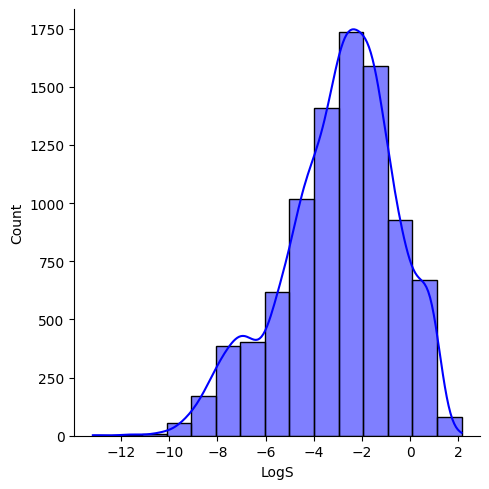

In [14]:
# Generate histogram to check data distribution in AqSol dataset
sns.displot(data=organic_compds, x='LogS', binwidth=1,color = 'blue', kde=True)

<Axes: xlabel='LogS'>

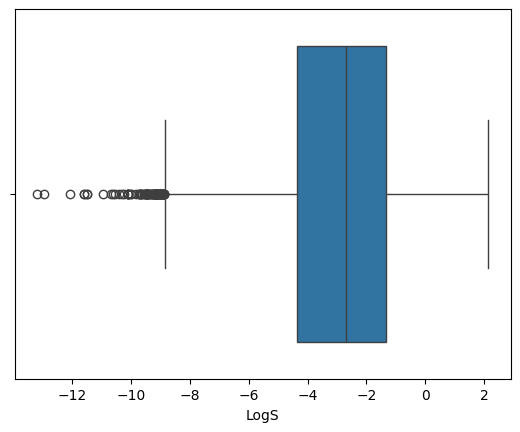

In [15]:
# Boxplot to view outliers 
sns.boxplot(data=organic_compds, x='LogS')

In [16]:
#filtering out outliers
organic_compds_filtered = organic_compds[(organic_compds['LogS'] > -8.7) & (organic_compds['LogS'] < 2.2)]

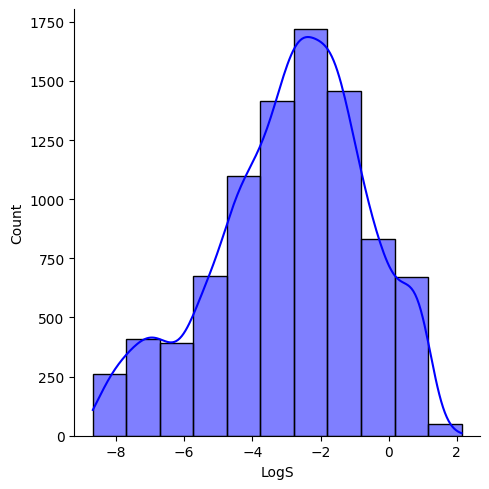

In [17]:
# Generate histogram
sns.displot(data=organic_compds_filtered, x='LogS', binwidth=1,color = 'blue', kde=True)

<Axes: xlabel='LogS'>

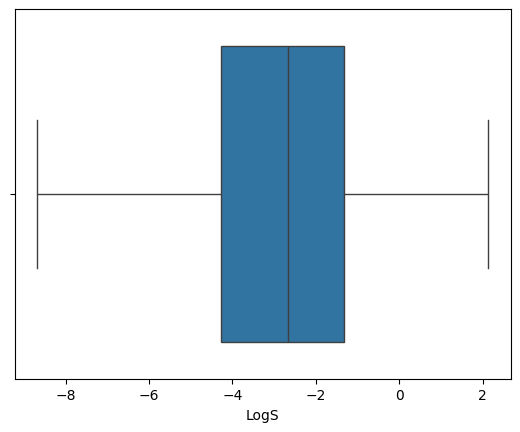

In [18]:
# Boxplot after removing outliers 
sns.boxplot(data=organic_compds_filtered, x='LogS')

In [19]:
organic_compds_filtered.shape

(8968, 2)

##### 2.4: Removing Outliers in external dataset 100 druglike compounds

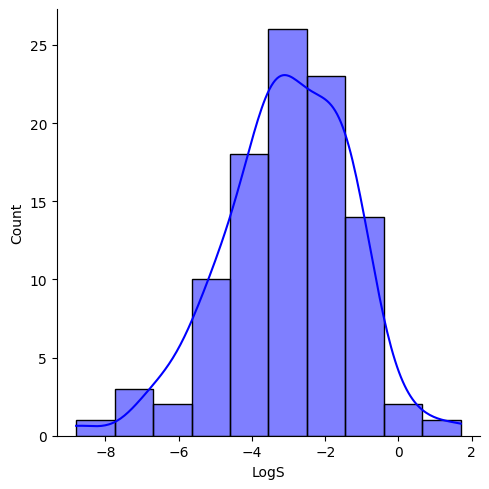

In [20]:
# Generate histogram to check data distribution
sns.displot(data=ext_test_set, x='LogS', binwidth=1,color = 'blue', kde=True)

<Axes: xlabel='LogS'>

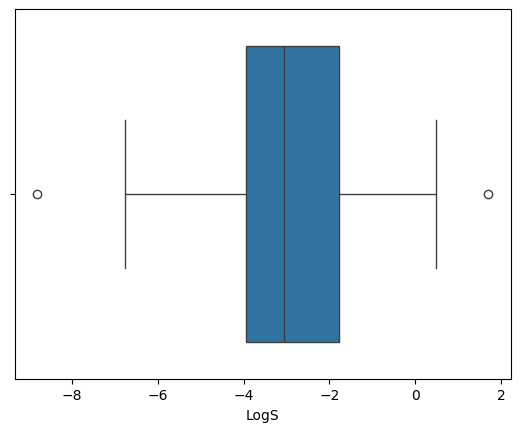

In [21]:
# Boxplot to view outliers 
sns.boxplot(data=ext_test_set, x='LogS')


In [22]:
# To remove outliers
# Calculate IQR
Q1 = ext_test_set['LogS'].quantile(0.25)
Q3 = ext_test_set['LogS'].quantile(0.75)
IQR = Q3 - Q1
	
# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
	
# Filter out outliers from the main dataset
ext_test_set_filtered = ext_test_set[(ext_test_set['LogS'] >= lower_bound) & (ext_test_set['LogS'] <= upper_bound)]
	
# Now ext_test_set_filtered contains the dataset without outliers

# #filtering out outliers
# organic_compds_filtered = organic_compds[(organic_compds['LogS'] > -8.7) & (organic_compds['LogS'] < 2.2)]


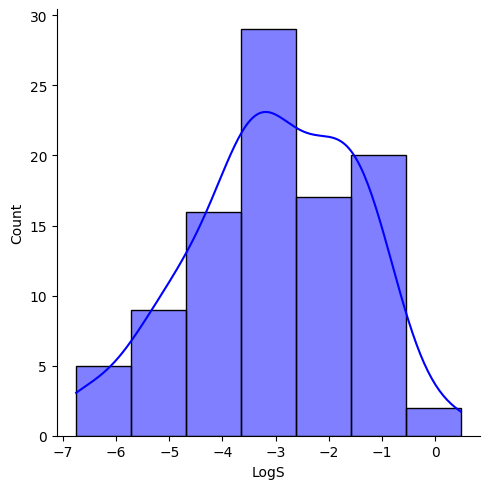

In [23]:
# Generate histogram
sns.displot(data=ext_test_set_filtered, x='LogS', binwidth=1,color = 'blue', kde=True)


<Axes: xlabel='LogS'>

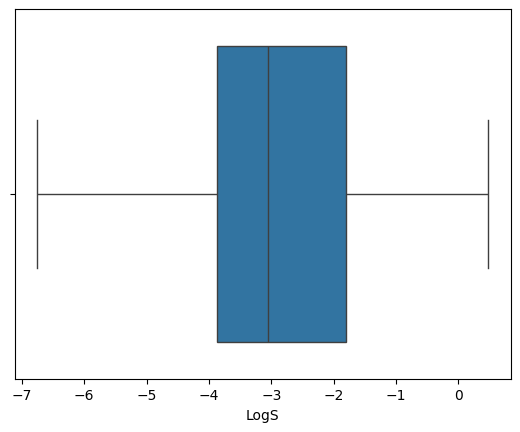

In [24]:
# Boxplot to view outliers 
sns.boxplot(data=ext_test_set_filtered, x='LogS')

In [25]:
ext_test_set_filtered.shape

(98, 3)

##### 2.4: Converting AqSol dataset SMILES to canonical SMILES and remove duplicate SMILES

In [26]:
# generate canonical SMILES
def canonical_SMILES(smiles):
    canon_smi = [Chem.CanonSmiles(smi) for smi in smiles]
    return canon_smi
# Generate canonical Smiles
canon_smiles = canonical_SMILES(organic_compds_filtered.SMILES)

# Replace SMILES column wit Canonical SMILES
organic_compds_filtered["SMILES"] = canon_smiles

# Create a list for duplicate smiles
duplicate_smiles = organic_compds_filtered[organic_compds_filtered['SMILES'].duplicated()]['SMILES'].values
len(duplicate_smiles)


[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:11] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not removing hydrogen atom without neighbors
[17:42:12] WARNING: not r

0

In [27]:
# filter the duplicate smiles and sort them based on smiles
organic_compds_filtered[organic_compds_filtered['SMILES'].isin(duplicate_smiles)].sort_values(by=['SMILES'])

,SMILES,LogS


In [28]:
# Drop rows that contain duplicate SMILES and keep the first Structure
organic_compds_cleaned= organic_compds_filtered.drop_duplicates(subset=['SMILES'], keep='first')
len(organic_compds_cleaned)

8968

##### 2.5: Converting external dataset SMILES to canonical SMILES and remove duplicate SMILES

In [29]:
# Generate canonical Smiles
canon_smiles = canonical_SMILES(ext_test_set_filtered.SMILES)

# Replace SMILES column wit Canonical SMILES
ext_test_set_filtered["SMILES"] = canon_smiles

# Create a list for duplicate smiles
duplicate_test_smiles = ext_test_set_filtered[ext_test_set_filtered['SMILES'].duplicated()]['SMILES'].values
len(duplicate_test_smiles)



0

##### 2.6: Removing external dataset from the AqSol dataset

In [30]:
# exclude structures that are present in the external test set AqSol data set 
ext_test_set_SMILES = ext_test_set_filtered.SMILES.values
organic_compds_cleaned_final = organic_compds_cleaned[~organic_compds_filtered['SMILES'].isin(ext_test_set_SMILES)]
print(f'Compounds present in AqSol dataset:{len(organic_compds_cleaned) - len(organic_compds_cleaned_final)}')

Compounds present in AqSol dataset:84


In [42]:
organic_compds_cleaned_final.to_csv('cleaned_data.csv',index=False)

##### 2.6: Solubility classification for AqSol dataset

In [31]:


# Define a function to classify LogS values
def classify_logS(logS):
    if logS > 0:
        return 'H'
    elif logS >= -2:
        return 'S'
    elif logS >= -4:
        return 'L'
    else:
        return 'I'

# Apply the classification function to the 'LogS' column
organic_compds_cleaned_final['Classification'] = organic_compds_cleaned_final['LogS'].apply(classify_logS)


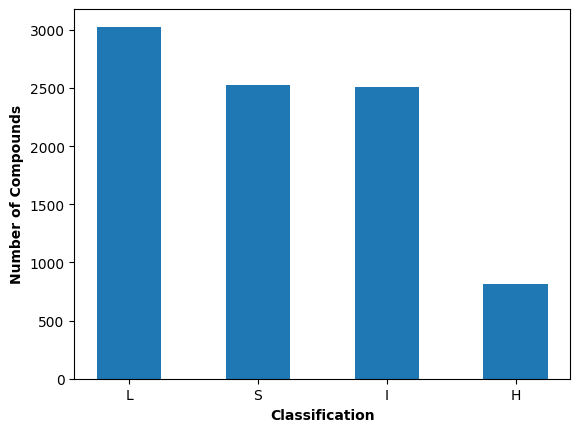

In [32]:
# Determine the number of compounds in each category
category_counts = organic_compds_cleaned_final['Classification'].value_counts()

# Plot a bar graph with narrower bars
plt.bar(category_counts.index, category_counts.values, width=0.5)  # Adjust the width as needed

# Add labels and title with bold font
plt.xlabel('Classification', fontweight='bold')
plt.ylabel('Number of Compounds', fontweight='bold')
#plt.title('Number of Compounds in Each Classification Category')

# Show plot
plt.show()


In [33]:
# Print the number of compounds in each category
print("Number of Compounds in Each Category:")
for category, count in category_counts.items():
    print(f"{category}: {count}")

Number of Compounds in Each Category:
L: 3028
S: 2527
I: 2511
H: 818


##### 2.7: Solubility classification for external dataset

In [34]:
# Apply the classification function to the 'LogS' column
ext_test_set_filtered['Classification'] = ext_test_set_filtered['LogS'].apply(classify_logS)


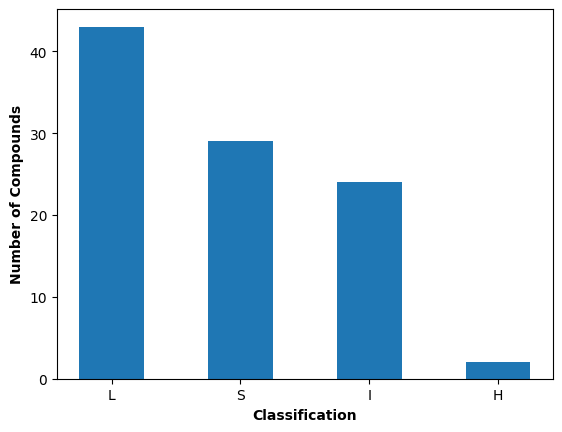

In [35]:

# Determine the number of compounds in each category
category_counts = ext_test_set_filtered['Classification'].value_counts()

# Plot a bar graph with narrower bars
plt.bar(category_counts.index, category_counts.values, width=0.5)  # Adjust the width as needed

# Add labels and title with bold font
plt.xlabel('Classification', fontweight='bold')
plt.ylabel('Number of Compounds', fontweight='bold')
#plt.title('Number of Compounds in Each Classification Category')

# Show plot
plt.show()



In [36]:
# Print the number of compounds in each category
print("Number of Compounds in Each Category:")
for category, count in category_counts.items():
    print(f"{category}: {count}")

Number of Compounds in Each Category:
L: 43
S: 29
I: 24
H: 2


### STEP 3: Data Processing (Generation of molecular features)

#### 3.1.Calculate RDkit Molecular Descriptors for AqSol Data set


In [37]:

def RDkit_descriptors(smiles):
    mols = [Chem.MolFromSmiles(i) for i in smiles]
    calc = MoleculeDescriptors.MolecularDescriptorCalculator([x[0] 
                                    for x in Descriptors._descList])
    desc_names = calc.GetDescriptorNames()
    
    Mol_descriptors = []
    for mol in tqdm(mols):
        try:
            # Sanitize the molecule
            Chem.SanitizeMol(mol)
            # Add hydrogens to molecules
            mol = Chem.AddHs(mol)
            # Calculate all available descriptors for each molecule
            descriptors = calc.CalcDescriptors(mol)
            Mol_descriptors.append(descriptors)
        except Exception as e:
            # Handle exceptions (e.g., logging the error, skipping the molecule)
            print(f"Error processing molecule: {Chem.MolToSmiles(mol)}. Error: {e}")
            Mol_descriptors.append([None] * len(desc_names))  # Append None for failed molecules

    return Mol_descriptors, desc_names

# Function call
Mol_descriptors, desc_names = RDkit_descriptors(organic_compds_cleaned_final['SMILES'])


[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not removing hydrogen atom without neighbors
[17:54:20] WARNING: not r

In [43]:
# Put the descriptors to dataframe
Dataset_with_210_descriptors = pd.DataFrame(Mol_descriptors,columns=desc_names)
Dataset_with_210_descriptors

,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,8.336894,8.336894,0.000000,-5.475964,0.259676,53.913043,392.510,346.142,391.281363,142,...,0,0,0,0,0,0,0,0,0,0
1,12.004486,12.004486,0.012037,-0.873148,0.644215,21.692308,169.183,162.127,169.052764,62,...,0,0,0,0,0,0,0,0,0,0
2,10.719698,10.719698,0.342593,-1.251235,0.546650,16.777778,140.569,135.529,140.002892,46,...,0,0,0,0,0,0,0,0,0,0
3,8.982102,8.982102,0.493228,-3.993033,0.490100,60.000000,422.525,392.285,422.220557,164,...,0,0,0,0,0,0,0,0,0,0
4,7.700116,7.700116,0.576736,-2.836395,0.531431,25.777778,118.179,108.099,118.078250,46,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8879,14.835384,14.835384,0.938716,-3.643147,0.885185,27.800000,356.418,339.282,356.088244,128,...,0,0,0,0,0,0,0,0,0,0
8880,12.812226,12.812226,0.685644,-4.175909,0.578688,34.789474,264.369,240.177,264.183778,106,...,0,0,0,0,0,0,0,0,0,0
8881,14.712939,14.712939,1.047269,-5.130725,0.336110,54.281250,444.440,420.248,444.153266,170,...,0,0,0,0,0,0,0,0,0,0
8882,11.083109,11.083109,0.640765,-5.540394,0.419905,34.909091,454.611,416.307,454.283158,180,...,0,0,0,0,0,0,0,0,0,0


In [44]:
col_210_desc = Dataset_with_210_descriptors.columns.tolist()
print(col_210_desc)

['MaxAbsEStateIndex', 'MaxEStateIndex', 'MinAbsEStateIndex', 'MinEStateIndex', 'qed', 'SPS', 'MolWt', 'HeavyAtomMolWt', 'ExactMolWt', 'NumValenceElectrons', 'NumRadicalElectrons', 'MaxPartialCharge', 'MinPartialCharge', 'MaxAbsPartialCharge', 'MinAbsPartialCharge', 'FpDensityMorgan1', 'FpDensityMorgan2', 'FpDensityMorgan3', 'BCUT2D_MWHI', 'BCUT2D_MWLOW', 'BCUT2D_CHGHI', 'BCUT2D_CHGLO', 'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'BCUT2D_MRLOW', 'AvgIpc', 'BalabanJ', 'BertzCT', 'Chi0', 'Chi0n', 'Chi0v', 'Chi1', 'Chi1n', 'Chi1v', 'Chi2n', 'Chi2v', 'Chi3n', 'Chi3v', 'Chi4n', 'Chi4v', 'HallKierAlpha', 'Ipc', 'Kappa1', 'Kappa2', 'Kappa3', 'LabuteASA', 'PEOE_VSA1', 'PEOE_VSA10', 'PEOE_VSA11', 'PEOE_VSA12', 'PEOE_VSA13', 'PEOE_VSA14', 'PEOE_VSA2', 'PEOE_VSA3', 'PEOE_VSA4', 'PEOE_VSA5', 'PEOE_VSA6', 'PEOE_VSA7', 'PEOE_VSA8', 'PEOE_VSA9', 'SMR_VSA1', 'SMR_VSA10', 'SMR_VSA2', 'SMR_VSA3', 'SMR_VSA4', 'SMR_VSA5', 'SMR_VSA6', 'SMR_VSA7', 'SMR_VSA8', 'SMR_VSA9', 'SlogP_VSA1', 'SlogP_VSA10', 'S

In [45]:
# Selectiing the 209 molecular
Dataset_with_209_descriptors = Dataset_with_210_descriptors[['MaxAbsEStateIndex', 'MaxEStateIndex', 'MinAbsEStateIndex', 'MinEStateIndex', 'qed', 'MolWt', 'HeavyAtomMolWt', 'ExactMolWt', 'NumValenceElectrons', 'NumRadicalElectrons', 'MaxPartialCharge', 'MinPartialCharge', 'MaxAbsPartialCharge', 'MinAbsPartialCharge', 'FpDensityMorgan1', 'FpDensityMorgan2', 'FpDensityMorgan3', 'BCUT2D_MWHI', 'BCUT2D_MWLOW', 'BCUT2D_CHGHI', 'BCUT2D_CHGLO', 'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'BCUT2D_MRLOW', 'AvgIpc', 'BalabanJ', 'BertzCT', 'Chi0', 'Chi0n', 'Chi0v', 'Chi1', 'Chi1n', 'Chi1v', 'Chi2n', 'Chi2v', 'Chi3n', 'Chi3v', 'Chi4n', 'Chi4v', 'HallKierAlpha', 'Ipc', 'Kappa1', 'Kappa2', 'Kappa3', 'LabuteASA', 'PEOE_VSA1', 'PEOE_VSA10', 'PEOE_VSA11', 'PEOE_VSA12', 'PEOE_VSA13', 'PEOE_VSA14', 'PEOE_VSA2', 'PEOE_VSA3', 'PEOE_VSA4', 'PEOE_VSA5', 'PEOE_VSA6', 'PEOE_VSA7', 'PEOE_VSA8', 'PEOE_VSA9', 'SMR_VSA1', 'SMR_VSA10', 'SMR_VSA2', 'SMR_VSA3', 'SMR_VSA4', 'SMR_VSA5', 'SMR_VSA6', 'SMR_VSA7', 'SMR_VSA8', 'SMR_VSA9', 'SlogP_VSA1', 'SlogP_VSA10', 'SlogP_VSA11', 'SlogP_VSA12', 'SlogP_VSA2', 'SlogP_VSA3', 'SlogP_VSA4', 'SlogP_VSA5', 'SlogP_VSA6', 'SlogP_VSA7', 'SlogP_VSA8', 'SlogP_VSA9', 'TPSA', 'EState_VSA1', 'EState_VSA10', 'EState_VSA11', 'EState_VSA2', 'EState_VSA3', 'EState_VSA4', 'EState_VSA5', 'EState_VSA6', 'EState_VSA7', 'EState_VSA8', 'EState_VSA9', 'VSA_EState1', 'VSA_EState10', 'VSA_EState2', 'VSA_EState3', 'VSA_EState4', 'VSA_EState5', 'VSA_EState6', 'VSA_EState7', 'VSA_EState8', 'VSA_EState9', 'FractionCSP3', 'HeavyAtomCount', 'NHOHCount', 'NOCount', 'NumAliphaticCarbocycles', 'NumAliphaticHeterocycles', 'NumAliphaticRings', 'NumAromaticCarbocycles', 'NumAromaticHeterocycles', 'NumAromaticRings', 'NumHAcceptors', 'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds', 'NumSaturatedCarbocycles', 'NumSaturatedHeterocycles', 'NumSaturatedRings', 'RingCount', 'MolLogP', 'MolMR', 'fr_Al_COO', 'fr_Al_OH', 'fr_Al_OH_noTert', 'fr_ArN', 'fr_Ar_COO', 'fr_Ar_N', 'fr_Ar_NH', 'fr_Ar_OH', 'fr_COO', 'fr_COO2', 'fr_C_O', 'fr_C_O_noCOO', 'fr_C_S', 'fr_HOCCN', 'fr_Imine', 'fr_NH0', 'fr_NH1', 'fr_NH2', 'fr_N_O', 'fr_Ndealkylation1', 'fr_Ndealkylation2', 'fr_Nhpyrrole', 'fr_SH', 'fr_aldehyde', 'fr_alkyl_carbamate', 'fr_alkyl_halide', 'fr_allylic_oxid', 'fr_amide', 'fr_amidine', 'fr_aniline', 'fr_aryl_methyl', 'fr_azide', 'fr_azo', 'fr_barbitur', 'fr_benzene', 'fr_benzodiazepine', 'fr_bicyclic', 'fr_diazo', 'fr_dihydropyridine', 'fr_epoxide', 'fr_ester', 'fr_ether', 'fr_furan', 'fr_guanido', 'fr_halogen', 'fr_hdrzine', 'fr_hdrzone', 'fr_imidazole', 'fr_imide', 'fr_isocyan', 'fr_isothiocyan', 'fr_ketone', 'fr_ketone_Topliss', 'fr_lactam', 'fr_lactone', 'fr_methoxy', 'fr_morpholine', 'fr_nitrile', 'fr_nitro', 'fr_nitro_arom', 'fr_nitro_arom_nonortho', 'fr_nitroso', 'fr_oxazole', 'fr_oxime', 'fr_para_hydroxylation', 'fr_phenol', 'fr_phenol_noOrthoHbond', 'fr_phos_acid', 'fr_phos_ester', 'fr_piperdine', 'fr_piperzine', 'fr_priamide', 'fr_prisulfonamd', 'fr_pyridine', 'fr_quatN', 'fr_sulfide', 'fr_sulfonamd', 'fr_sulfone', 'fr_term_acetylene', 'fr_tetrazole', 'fr_thiazole', 'fr_thiocyan', 'fr_thiophene', 'fr_unbrch_alkane', 'fr_urea']]
# Dataset_with_209_descriptors.to_csv('dataset_for_train_and_test_set.csv',index=False)
Dataset_with_209_descriptors.shape




(8884, 209)

#### STEP 4: Select Machine Learning Models

##### 4.1: Using Lazy predict to check the most accurate regressor model



In [71]:
# Train-validation split
X_train, X_valid, y_train, y_valid= train_test_split(Dataset_with_209_descriptors,
                                                      organic_compds_cleaned_final.LogS,
                                                      test_size=0.2,random_state=42)
# Print the sizes of the resulting datasets
print("Train set:", X_train.shape, y_train.shape)
print("Test set:", X_valid.shape, y_valid.shape)


Train set: (7107, 209) (7107,)
Test set: (1777, 209) (1777,)


In [72]:
#Standardize the features
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

In [73]:
# https://github.com/shankarpandala/lazypredict
# Training the model with Lazypredict as to know the most accurate regressor model among the 42 [regressors]
lregs = LazyRegressor(verbose=0,ignore_warnings=True, custom_metric=None,random_state=42)
models, prediction_tests = lregs.fit(X_train_scaled, X_valid_scaled, y_train, y_valid)

 98%|█████████▊| 41/42 [09:27<00:08,  8.53s/it]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022996 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20542
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 193
[LightGBM] [Info] Start training from score -2.882603


100%|██████████| 42/42 [09:30<00:00, 13.58s/it]


In [74]:
#The  models
prediction_tests[:42]

#Here we selected LGMRegressor Model because of it higher R-Squared value and less computing time

,Adjusted R-Squared,R-Squared,RMSE,Time Taken
Model,,,,
LGBMRegressor,0.85,0.87,0.83,2.46
HistGradientBoostingRegressor,0.85,0.87,0.83,16.91
ExtraTreesRegressor,0.84,0.86,0.84,93.59
XGBRegressor,0.84,0.86,0.84,6.36
RandomForestRegressor,0.83,0.85,0.88,192.76
GradientBoostingRegressor,0.81,0.84,0.92,40.31
BaggingRegressor,0.81,0.83,0.92,33.11
SVR,0.81,0.83,0.93,16.09
NuSVR,0.81,0.83,0.93,13.49


In [75]:
# Saving the output of LazyPredict
prediction_tests.to_csv('predcition_test.csv', index = False)

#### STEP 5: Fine-tune the Selected Model

In [76]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform

# Define parameter distributions
params = {'max_depth': randint(19, 36),  # Random integer between 19 and 36
          'n_estimators': randint(900, 1200),  # Random integer between 900 and 1200
          'learning_rate': uniform(0.01, 0.04)}  # Random float between 0.01 and 0.05

# Create RandomizedSearchCV object
random_search_gbr_ref = RandomizedSearchCV(LGBMRegressor(random_state=42),
                                           param_distributions=params,
                                           n_iter=10,  # Number of iterations
                                           cv=3,
                                           n_jobs=4,
                                           verbose=1)

# Fit RandomizedSearchCV object to training data
random_search_gbr_ref.fit(X_train_scaled, y_train)

# Retrieve best hyperparameters
print("The best parameters are: ", random_search_gbr_ref.best_params_)

#The best parameters are:  {'learning_rate': 0.028832701453220762, 'max_depth': 35, 'n_estimators': 1098}

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019690 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20568
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 193
[LightGBM] [Info] Start training from score -2.882603
The best parameters are:  {'learning_rate': 0.028832701453220762, 'max_depth': 35, 'n_estimators': 1098}


#### 6.0: Use the Optimal Model for testing Validation set and for blind test

In [77]:
# Instantiate the models
model = LGBMRegressor(n_estimators=1098, max_depth=35, learning_rate=0.028832701453220762, random_state=42)

In [80]:
# Fit your model (model) on the validation data
model.fit(X_train_scaled, y_train)

# Predict on both training and validation sets
y_train_pred = model.predict(X_train_scaled)
y_valid_pred =model.predict(X_valid_scaled)

# Calculate R2 scores
r2_train = r2_score(y_train, y_train_pred)
r2_valid = r2_score(y_valid, y_valid_pred)

# Calculate RMSE
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse_valid = np.sqrt(mean_squared_error(y_valid, y_valid_pred))

# Print the results
print("R2 Score - Train:", round(r2_train, 2))
print("RMSE - Train:", round(rmse_train, 2))
print("R2 Score - Valid:", round(r2_valid, 2))
print("RMSE - Valid:", round(rmse_valid, 2))


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030248 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20568
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 193
[LightGBM] [Info] Start training from score -2.882603
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
R2 Score - Train: 0.98
RMSE - Train: 0.33
R2 Score - Test: 0.87
RMSE - Test: 0.81
[LightGBM] [Warning] Accuracy may be bad since you did

#### 6.1: Scatter plots of train, validation and test set(blind test).

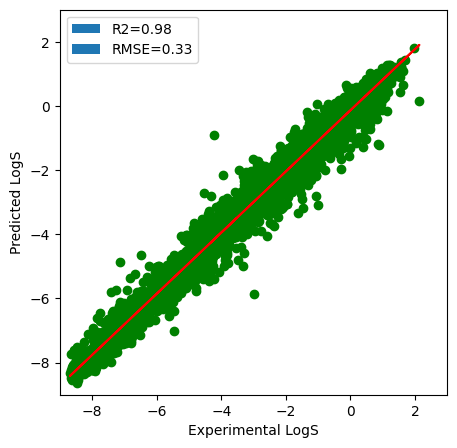

In [81]:

# Define the plot_data function
def plot_data(actual, predicted):
    # model performance using RMSE
    rmse = np.sqrt(mean_squared_error(actual, predicted))

    # R^2 (coefficient of determination) :
    R2 = r2_score(actual, predicted)
    plt.figure(figsize=(5, 5))

    # Plot the data points
    plt.scatter(actual, predicted, color='green', label='Data Points')

    # Add trendline for test data
    z_test = np.polyfit(actual, predicted, 1)
    p_test = np.poly1d(z_test)
    plt.plot(actual, p_test(actual), color='red', label='Trendline')

    # Label and title
    #plt.title(title, color='black')
    plt.xlabel('Experimental LogS', color='black')
    plt.ylabel('Predicted LogS', color='black')

    # Set x-axis and y-axis limits
    plt.xlim(-9, 3)
    plt.ylim(-9, 3)

    # Add legend at top left
    R2_patch = mpatches.Patch(label="R2={:04.2f}".format(R2))
    rmse_patch = mpatches.Patch(label="RMSE={:04.2f}".format(rmse))
    plt.legend(handles=[R2_patch, rmse_patch], loc='upper left')

    plt.show()

# Call the plot_data function to plot the actual vs predicted values
plot_data(y_train, y_train_pred)



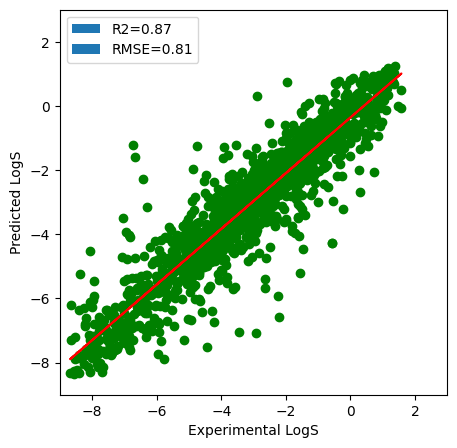

In [141]:
# Scatter plot of validation set

plot_data(y_test, y_test_pred)
# Create a DataFrame to store actual and predicted values
plot_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_test_pred})

plot_df.to_csv('results_of_exp_and_pred.csv', index=False)


##### 6.2: Blind test using external dataset (100-drug like molecules but have been reduced to 98 due to outlier removal)

In [48]:
#Calculate molecular descriptors for the external test data or 98 compounds
Mol_descriptors_test,desc_names_test = RDkit_descriptors(ext_test_set_filtered['SMILES'])
ext_test_set_with_210_descriptors = pd.DataFrame(Mol_descriptors_test,columns=desc_names_test)
ext_test_set_with_210_descriptors

  0%|          | 0/98 [00:00<?, ?it/s][18:59:27] DEPRECATION WARNING: please use MorganGenerator
[18:59:27] DEPRECATION WARNING: please use MorganGenerator
[18:59:27] DEPRECATION WARNING: please use MorganGenerator
[18:59:27] 

****
Pre-condition Violation
bad result vector size
Violation occurred on line 42 in file C:\rdkit\build\temp.win-amd64-cpython-312\Release\rdkit\Code\GraphMol\Descriptors\Crippen.cpp
Failed Expression: logpContribs.size() == mol.getNumAtoms() && mrContribs.size() == mol.getNumAtoms()
****

[18:59:27] 

****
Pre-condition Violation
bad result vector size
Violation occurred on line 42 in file C:\rdkit\build\temp.win-amd64-cpython-312\Release\rdkit\Code\GraphMol\Descriptors\Crippen.cpp
Failed Expression: logpContribs.size() == mol.getNumAtoms() && mrContribs.size() == mol.getNumAtoms()
****

[18:59:27] 

****
Pre-condition Violation
bad result vector size
Violation occurred on line 42 in file C:\rdkit\build\temp.win-amd64-cpython-312\Release\rdkit\Code\GraphMol\De

,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,11.416911,11.416911,0.187315,-3.134279,0.622799,23.000000,135.166,126.094,135.068414,52,...,0,0,0,0,0,0,0,0,0,0
1,8.665559,8.665559,0.094310,-3.728552,0.490520,56.736842,267.245,254.141,267.096754,102,...,0,0,0,0,0,0,0,0,0,0
2,7.342685,7.342685,0.016435,-0.381343,0.536540,15.600000,136.114,132.082,136.038511,50,...,0,0,0,0,0,0,0,0,0,0
3,8.630251,8.630251,0.220508,-3.463490,0.853356,24.761905,290.323,272.179,290.137890,112,...,0,0,0,0,0,0,0,0,0,0
4,11.317698,11.317698,0.109208,-4.501109,0.631859,19.153846,222.251,216.203,221.988132,72,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,11.596115,11.596115,0.170332,-4.815000,0.580551,21.545455,172.209,164.145,172.030648,60,...,0,1,0,0,0,0,0,0,0,0
94,13.146746,13.146746,0.850132,-5.952619,0.886038,57.545455,323.418,302.250,323.130363,120,...,0,1,0,0,0,0,0,0,0,1
95,9.412466,9.412466,1.280461,-5.328023,0.874710,70.272727,301.474,270.226,301.240565,122,...,0,0,0,0,0,0,0,0,0,0
96,8.358943,8.358943,0.207842,-0.609817,0.365178,20.666667,228.294,216.198,228.093900,84,...,0,0,0,0,0,0,0,0,0,0


In [51]:
ext_test_set_filtered.to_csv('external_data_filtered.csv',index=False)
#Choosing only 209 molecualar decriptors
ext_test_set_with_209_descriptors =ext_test_set_with_210_descriptors[['MaxAbsEStateIndex', 'MaxEStateIndex', 'MinAbsEStateIndex', 'MinEStateIndex', 'qed','MolWt', 'HeavyAtomMolWt', 'ExactMolWt', 'NumValenceElectrons', 'NumRadicalElectrons', 'MaxPartialCharge', 'MinPartialCharge', 'MaxAbsPartialCharge', 'MinAbsPartialCharge', 'FpDensityMorgan1', 'FpDensityMorgan2', 'FpDensityMorgan3', 'BCUT2D_MWHI', 'BCUT2D_MWLOW', 'BCUT2D_CHGHI', 'BCUT2D_CHGLO', 'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'BCUT2D_MRLOW', 'AvgIpc', 'BalabanJ', 'BertzCT', 'Chi0', 'Chi0n', 'Chi0v', 'Chi1', 'Chi1n', 'Chi1v', 'Chi2n', 'Chi2v', 'Chi3n', 'Chi3v', 'Chi4n', 'Chi4v', 'HallKierAlpha', 'Ipc', 'Kappa1', 'Kappa2', 'Kappa3', 'LabuteASA', 'PEOE_VSA1', 'PEOE_VSA10', 'PEOE_VSA11', 'PEOE_VSA12', 'PEOE_VSA13', 'PEOE_VSA14', 'PEOE_VSA2', 'PEOE_VSA3', 'PEOE_VSA4', 'PEOE_VSA5', 'PEOE_VSA6', 'PEOE_VSA7', 'PEOE_VSA8', 'PEOE_VSA9', 'SMR_VSA1', 'SMR_VSA10', 'SMR_VSA2', 'SMR_VSA3', 'SMR_VSA4', 'SMR_VSA5', 'SMR_VSA6', 'SMR_VSA7', 'SMR_VSA8', 'SMR_VSA9', 'SlogP_VSA1', 'SlogP_VSA10', 'SlogP_VSA11', 'SlogP_VSA12', 'SlogP_VSA2', 'SlogP_VSA3', 'SlogP_VSA4', 'SlogP_VSA5', 'SlogP_VSA6', 'SlogP_VSA7', 'SlogP_VSA8', 'SlogP_VSA9', 'TPSA', 'EState_VSA1', 'EState_VSA10', 'EState_VSA11', 'EState_VSA2', 'EState_VSA3', 'EState_VSA4', 'EState_VSA5', 'EState_VSA6', 'EState_VSA7', 'EState_VSA8', 'EState_VSA9', 'VSA_EState1', 'VSA_EState10', 'VSA_EState2', 'VSA_EState3', 'VSA_EState4', 'VSA_EState5', 'VSA_EState6', 'VSA_EState7', 'VSA_EState8', 'VSA_EState9', 'FractionCSP3', 'HeavyAtomCount', 'NHOHCount', 'NOCount', 'NumAliphaticCarbocycles', 'NumAliphaticHeterocycles', 'NumAliphaticRings', 'NumAromaticCarbocycles', 'NumAromaticHeterocycles', 'NumAromaticRings', 'NumHAcceptors', 'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds', 'NumSaturatedCarbocycles', 'NumSaturatedHeterocycles', 'NumSaturatedRings', 'RingCount', 'MolLogP', 'MolMR', 'fr_Al_COO', 'fr_Al_OH', 'fr_Al_OH_noTert', 'fr_ArN', 'fr_Ar_COO', 'fr_Ar_N', 'fr_Ar_NH', 'fr_Ar_OH', 'fr_COO', 'fr_COO2', 'fr_C_O', 'fr_C_O_noCOO', 'fr_C_S', 'fr_HOCCN', 'fr_Imine', 'fr_NH0', 'fr_NH1', 'fr_NH2', 'fr_N_O', 'fr_Ndealkylation1', 'fr_Ndealkylation2', 'fr_Nhpyrrole', 'fr_SH', 'fr_aldehyde', 'fr_alkyl_carbamate', 'fr_alkyl_halide', 'fr_allylic_oxid', 'fr_amide', 'fr_amidine', 'fr_aniline', 'fr_aryl_methyl', 'fr_azide', 'fr_azo', 'fr_barbitur', 'fr_benzene', 'fr_benzodiazepine', 'fr_bicyclic', 'fr_diazo', 'fr_dihydropyridine', 'fr_epoxide', 'fr_ester', 'fr_ether', 'fr_furan', 'fr_guanido', 'fr_halogen', 'fr_hdrzine', 'fr_hdrzone', 'fr_imidazole', 'fr_imide', 'fr_isocyan', 'fr_isothiocyan', 'fr_ketone', 'fr_ketone_Topliss', 'fr_lactam', 'fr_lactone', 'fr_methoxy', 'fr_morpholine', 'fr_nitrile', 'fr_nitro', 'fr_nitro_arom', 'fr_nitro_arom_nonortho', 'fr_nitroso', 'fr_oxazole', 'fr_oxime', 'fr_para_hydroxylation', 'fr_phenol', 'fr_phenol_noOrthoHbond', 'fr_phos_acid', 'fr_phos_ester', 'fr_piperdine', 'fr_piperzine', 'fr_priamide', 'fr_prisulfonamd', 'fr_pyridine', 'fr_quatN', 'fr_sulfide', 'fr_sulfonamd', 'fr_sulfone', 'fr_term_acetylene', 'fr_tetrazole', 'fr_thiazole', 'fr_thiocyan', 'fr_thiophene', 'fr_unbrch_alkane', 'fr_urea']]

ext_test_set_with_209_descriptors.to_csv('blind_test_data.csv', index=False)
ext_test_set_with_209_descriptors

,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,NumRadicalElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,11.416911,11.416911,0.187315,-3.134279,0.622799,135.166,126.094,135.068414,52,0,...,0,0,0,0,0,0,0,0,0,0
1,8.665559,8.665559,0.094310,-3.728552,0.490520,267.245,254.141,267.096754,102,0,...,0,0,0,0,0,0,0,0,0,0
2,7.342685,7.342685,0.016435,-0.381343,0.536540,136.114,132.082,136.038511,50,0,...,0,0,0,0,0,0,0,0,0,0
3,8.630251,8.630251,0.220508,-3.463490,0.853356,290.323,272.179,290.137890,112,0,...,0,0,0,0,0,0,0,0,0,0
4,11.317698,11.317698,0.109208,-4.501109,0.631859,222.251,216.203,221.988132,72,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,11.596115,11.596115,0.170332,-4.815000,0.580551,172.209,164.145,172.030648,60,0,...,0,1,0,0,0,0,0,0,0,0
94,13.146746,13.146746,0.850132,-5.952619,0.886038,323.418,302.250,323.130363,120,0,...,0,1,0,0,0,0,0,0,0,1
95,9.412466,9.412466,1.280461,-5.328023,0.874710,301.474,270.226,301.240565,122,0,...,0,0,0,0,0,0,0,0,0,0
96,8.358943,8.358943,0.207842,-0.609817,0.365178,228.294,216.198,228.093900,84,0,...,0,0,0,0,0,0,0,0,0,0


In [87]:
# Standard scaler - transform
X_scaled_test = scaler.transform(ext_test_set_with_209_descriptors)

In [88]:
# Predict solubility of the test data
y_test_preds = model.predict(X_scaled_test)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


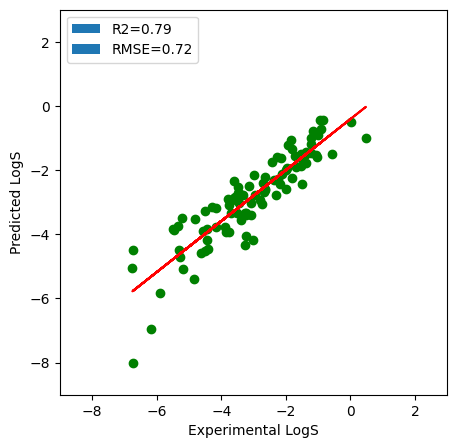

In [90]:
# function call for plotting testing set
plot_data(ext_test_set_filtered['LogS'], y_test_preds)


#### STEP 7. Save the Trained Model and Standard Scaler for New Data


In [92]:
import pickle
with open('model.pkl','wb') as f:
    pickle.dump(model,f)
with open('scaler.pkl','wb') as f:
    pickle.dump(scaler,f)

##### 7.1: Loading the model and standard scaler

In [ ]:
import pickle

with open('model.pkl', 'rb') as f:
    model = pickle.load(f)

with open('scaler.pkl', 'rb') as f:
    scaler = pickle.load(f)


### SECTION TWO: AVALON FINGERPRINT AS MOLECULAR FEATURE FOR AQUEOUS SOLUBILITY PREDICTION

#### STEP 1: Loading the clean datasets (AqSol dataset and 98-drug like dataset for blind test)

In [93]:
organic_compds_cleaned_final



,SMILES,LogS,Classification
0,CCCCCCCCCCCCCCCCCC[N+](C)(C)C.[Br-],-3.62,L
1,O=C1Nc2cccc3cccc1c23,-3.25,L
2,O=Cc1ccc(Cl)cc1,-2.18,L
4,c1cc(N(CC2CO2)CC2CO2)ccc1Cc1ccc(N(CC2CO2)CC2CO...,-4.66,I
5,C=Cc1cccc(C)c1,-3.12,L
...,...,...,...
9976,CC1=C(CC(=O)O)c2cc(F)ccc2/C1=C/c1ccc(S(C)=O)cc1,-4.50,I
9977,CCCCNc1ccc(C(=O)OCCN(C)C)cc1,-3.01,L
9978,CN(C)[C@@H]1C(O)=C(C(N)=O)C(=O)[C@@]2(O)C(O)=C...,-2.93,L
9980,COc1ccc(CCN(C)CCCC(C#N)(c2ccc(OC)c(OC)c2)C(C)C...,-3.98,L


In [94]:
ext_test_set_filtered

,Name,SMILES,LogS,Classification
0,Acetanilide,CC(=O)Nc1ccccc1,-1.40,S
1,Adenosine,Nc1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O,-1.73,S
2,Allopurinol,Oc1ncnc2[nH]ncc12,-2.26,L
3,Trimethoprim,COc1cc(Cc2cnc(N)nc2N)cc(OC)c1OC,-2.95,L
4,Acetazolamide,CC(=O)Nc1nnc(S(N)(=O)=O)s1,-2.44,L
...,...,...,...,...
95,Sulfanilamide,Nc1ccc(S(N)(=O)=O)cc1,-1.36,S
96,Gliclazide,Cc1ccc(S(=O)(=O)NC(=O)NN2CC3CCCC3C2)cc1,-4.29,I
97,Trihexyphenidyl,OC(CCN1CCCCC1)(c1ccccc1)C1CCCCC1,-5.20,I
98,Triphenylene,c1ccc2c(c1)c1ccccc1c1ccccc21,-6.73,I


In [52]:
# include 2D structures of molecules of the AqSol dataset
PandasTools.AddMoleculeColumnToFrame(organic_compds_cleaned_final,'SMILES','Structure',includeFingerprints=True)

[19:45:02] WARNING: not removing hydrogen atom without neighbors
[19:45:02] WARNING: not removing hydrogen atom without neighbors
[19:45:02] WARNING: not removing hydrogen atom without neighbors
[19:45:02] WARNING: not removing hydrogen atom without neighbors
[19:45:03] WARNING: not removing hydrogen atom without neighbors
[19:45:03] WARNING: not removing hydrogen atom without neighbors
[19:45:03] WARNING: not removing hydrogen atom without neighbors
[19:45:03] WARNING: not removing hydrogen atom without neighbors
[19:45:03] WARNING: not removing hydrogen atom without neighbors
[19:45:05] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not removing hydrogen atom without neighbors
[19:45:06] WARNING: not r

In [55]:
organic_compds_cleaned_final
organic_compds_cleaned_final.to_csv('Avl_fngt.csv',index=False)

#### STEP 2: Generation of Avalon fingerprint

In [56]:
#Function to generate Avalon fingerprint
def generate_AVfpts(data):
    
    # Store fingerprints using empty lists
    
    Avalon_fpts = []
    
    # Here no need to generate mol files
    # We can directly use the structure column of the data frame
    # mols = [Chem.MolFromSmiles(x) for x in data if x is not None]
    for mol in tqdm(data):
      
               
        #=============================
        # calculate Avalon fingerprints
        #=============================
        avfpts = pyAvalonTools.GetAvalonFP(mol, nBits=4096)
        Avalon_fpts.append(avfpts)
        
        
    #=====append=========================
    # return the lists as numpy array 
    #====================================
    return np.array(Avalon_fpts)


Avalon_fpts = generate_AVfpts(organic_compds_cleaned_final['Structure'])

100%|██████████| 8884/8884 [00:15<00:00, 560.11it/s]


In [57]:
# Put Avalon fingerprints into Dataframe
Avalon_fingerprints = pd.DataFrame(Avalon_fpts, columns=['Col_A_{}'.format(i + 1) 
                                                        for i in range(Avalon_fpts.shape[1])])
#View the dataframe
Avalon_fingerprints.to_csv('Avalon_fnpt.csv', index=False)
Avalon_fingerprints.head()

,Col_A_1,Col_A_2,Col_A_3,Col_A_4,Col_A_5,Col_A_6,Col_A_7,Col_A_8,Col_A_9,Col_A_10,...,Col_A_4087,Col_A_4088,Col_A_4089,Col_A_4090,Col_A_4091,Col_A_4092,Col_A_4093,Col_A_4094,Col_A_4095,Col_A_4096
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
1,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


#### STEP 2: Select Machine Learning Models

##### 2.1: Using Lazy predict to check the most accurate regressor model



In [105]:
# Train-validation split
X_train_av, X_valid_av, y_train_av, y_valid_av = train_test_split(Avalon_fingerprints,
                                                      organic_compds_cleaned_final.LogS,
                                                      test_size=0.2,random_state=42)
# Print the sizes of the resulting datasets
print("Train set:", X_train_av.shape, y_train_av.shape)
print("Test set:", X_valid_av.shape, y_valid_av.shape)


Train set: (7107, 4096) (7107,)
Test set: (1777, 4096) (1777,)


In [129]:
#Standardize the features
scaler_av = StandardScaler()
scaler_av.fit(X_train_av)
X_train_scaled_av = scaler_av.transform(X_train_av)
X_valid_scaled_av = scaler_av.transform(X_valid_av)

In [107]:
# https://github.com/shankarpandala/lazypredict
# Training the model with Lazypredict as to know the most accurate regressor model among the 42 [regressors]
lregs = LazyRegressor(verbose=0,ignore_warnings=True, custom_metric=None,random_state=42)
models, prediction_tests = lregs.fit(X_train_scaled_av, X_valid_scaled_av, y_train_av, y_valid_av)
#The  models
prediction_tests[:42]

#Here we selected LGMRegressor Model because of it higher R-Squared value and less computing time

 98%|█████████▊| 41/42 [6:26:50<05:40, 340.15s/it]    

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.150613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 8250
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 2750
[LightGBM] [Info] Start training from score -2.882603


100%|██████████| 42/42 [6:27:15<00:00, 553.22s/it]


,Adjusted R-Squared,R-Squared,RMSE,Time Taken
Model,,,,
SGDRegressor,254991288031464323547136.00,-333096727608669623025664.00,1306746853109.09,8.20
TransformedTargetRegressor,201891860315694600028160.00,-263732610322303752863744.00,1162754948498.99,70.12
LinearRegression,201891860315694600028160.00,-263732610322303752863744.00,1162754948498.99,71.46
RANSACRegressor,653370888338200461312.00,-853502511793144725504.00,66146776019.38,15756.97
KernelRidge,5.80,-5.27,5.67,20.14
Ridge,4.64,-3.76,4.94,17.64
LinearSVR,4.00,-2.92,4.48,80.12
GaussianProcessRegressor,2.70,-1.22,3.37,365.78
RidgeCV,2.02,-0.33,2.61,150.29


#### STEP 3: Fine-tune the Selected Model

In [108]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform

# Define parameter distributions
params = {'max_depth': randint(19, 36),  # Random integer between 19 and 36
          'n_estimators': randint(900, 1200),  # Random integer between 900 and 1200
          'learning_rate': uniform(0.01, 0.04)}  # Random float between 0.01 and 0.05

# Create RandomizedSearchCV object
random_search_gbr_ref = RandomizedSearchCV(LGBMRegressor(random_state=42),
                                           param_distributions=params,
                                           n_iter=10,  # Number of iterations
                                           cv=3,
                                           n_jobs=4,
                                           verbose=1)

# Fit RandomizedSearchCV object to training data
random_search_gbr_ref.fit(X_train_scaled_av, y_train_av)

# Retrieve best hyperparameters
print("The best parameters are: ", random_search_gbr_ref.best_params_)

#The best parameters are:  {'learning_rate': 0.028832701453220762, 'max_depth': 35, 'n_estimators': 1098}

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.138273 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 8250
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 2750
[LightGBM] [Info] Start training from score -2.882603
The best parameters are:  {'learning_rate': 0.04730581778155406, 'max_depth': 31, 'n_estimators': 1103}


#### 4.0: Use the Optimal Model for testing Validation set and for blind test

In [109]:
# Instantiate the models
model_av = LGBMRegressor(n_estimators=1103, max_depth=31, learning_rate=0.04730581778155406, random_state=42)

In [117]:

# Fit your model (model) on the validation data
model_av.fit(X_train_scaled_av, y_train_av)

# Predict on both training and validation sets
y_train_pred_av = model_av.predict(X_train_scaled_av)
y_valid_pred_av =model_av.predict(X_valid_scaled_av)

# Calculate R2 scores
r2_train_av = r2_score(y_train_av, y_train_pred_av)
r2_valid_av = r2_score(y_valid_av, y_valid_pred_av)

# Calculate RMSE
rmse_train_av = np.sqrt(mean_squared_error(y_train_av, y_train_pred_av))
rmse_valid_av = np.sqrt(mean_squared_error(y_valid_av, y_valid_pred_av))

# Print the results
print("R2 Score - Train:", round(r2_train_av, 2))
print("RMSE - Train:", round(rmse_train_av, 2))
print("R2 Score - Test:", round(r2_valid_av, 2))
print("RMSE - Test:", round(rmse_valid_av, 2))




[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.168170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 8250
[LightGBM] [Info] Number of data points in the train set: 7107, number of used features: 2750
[LightGBM] [Info] Start training from score -2.882603
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
R2 Score - Train: 0.94
RMSE - Train: 0.55
R2 Score - Test: 0.82
RMSE - T

#### 4.1: Scatter plots of train, validation and test set(blind test).




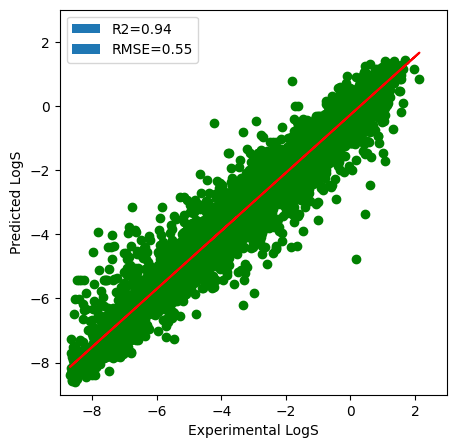

In [118]:
# Applying the already defined function
# Call the plot_data function to plot the actual vs predicted values for train set
plot_data(y_train_av, y_train_pred_av)

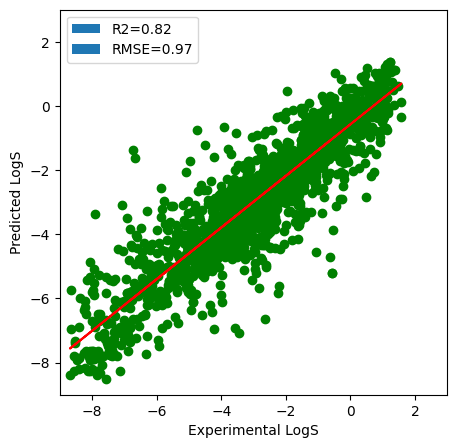

In [120]:
# Scatter plot of validation set

plot_data(y_valid_av, y_valid_pred_av)
# Create a DataFrame to store actual and predicted values
plot_df = pd.DataFrame({'Actual': y_valid_av, 'Predicted': y_valid_pred_av})

plot_df.to_csv(r'C:\Users\daniel\results_of_exp_and_pred.csv', index=False)

##### 4.2: Blind test using external dataset (100-drug like molecules but have been reduced to 98 due to outlier removal)

In [58]:
# include 2D structures of molecules of the AqSol dataset
PandasTools.AddMoleculeColumnToFrame(ext_test_set_filtered,'SMILES','Structure',includeFingerprints=True)


In [59]:
ext_test_set_filtered.to_csv('ext_avl_fnpt.csv', index=False)

In [60]:

Avalon_fpts_ext = generate_AVfpts(ext_test_set_filtered['Structure'])# Put Avalon fingerprints into Dataframe
Avalon_fingerprints_ext = pd.DataFrame(Avalon_fpts_ext, columns=['Col_A_{}'.format(i + 1) 
                                                        for i in range(Avalon_fpts_ext.shape[1])])
#View the dataframe
Avalon_fingerprints_ext.head()

100%|██████████| 98/98 [00:00<00:00, 490.83it/s]


,Col_A_1,Col_A_2,Col_A_3,Col_A_4,Col_A_5,Col_A_6,Col_A_7,Col_A_8,Col_A_9,Col_A_10,...,Col_A_4087,Col_A_4088,Col_A_4089,Col_A_4090,Col_A_4091,Col_A_4092,Col_A_4093,Col_A_4094,Col_A_4095,Col_A_4096
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0


In [61]:
Avalon_fingerprints_ext.to_csv('ext_avalon_fgpt.csv', index=False)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


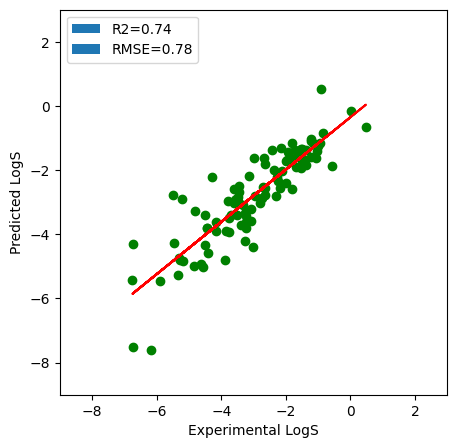

In [127]:
# Standard scaler - transform
X_scaled_test_av_ext = scaler.transform(Avalon_fingerprints_ext)
# Predict solubility of the test data
y_test_preds_av_ext = model_av.predict(X_scaled_test_av_ext)
# function call for plotting testing set
plot_data(ext_test_set_filtered['LogS'], y_test_preds_av_ext)


#### STEP 5. Save the Trained Model and Standard Scaler for New Data


In [131]:
import pickle
with open('model_av.pkl','wb') as f:
    pickle.dump(model_av,f)
with open('scaler_av.pkl','wb') as f:
    pickle.dump(scaler_av,f)

##### 5.1: Loading the model and standard scaler

In [132]:
# import pickle
with open('model_av.pkl', 'rb') as f:
    model_av = pickle.load(f)

with open('scaler_av.pkl', 'rb') as f:
    scaler_av = pickle.load(f)


##### Comparing the predicted results of the two models on external dataset

In [134]:
# Create pred_analysis DataFrame
ext_dataset_ev = pd.DataFrame({
    'Name': ext_test_set_filtered['Name'],
    'Experimental LogS (mol/L)': ext_test_set_filtered['LogS'],
    'Aqon 1 LogS predicted': y_test_preds,
    'Aqon 2 LogS predicted': y_test_preds_av_ext,
    
})

In [135]:
ext_dataset_ev

,Name,Experimental LogS (mol/L),Aqon 1 LogS predicted,Aqon 2 LogS predicted
0,Acetanilide,-1.40,-1.53,-1.69
1,Adenosine,-1.73,-1.57,-1.36
2,Allopurinol,-2.26,-1.59,-2.22
3,Trimethoprim,-2.95,-2.78,-2.81
4,Acetazolamide,-2.44,-1.74,-1.39
...,...,...,...,...
95,Sulfanilamide,-1.36,-1.45,-1.38
96,Gliclazide,-4.29,-3.16,-2.20
97,Trihexyphenidyl,-5.20,-3.48,-2.90
98,Triphenylene,-6.73,-8.01,-7.50


In [136]:


# Calculate absolute error between 'Experimental LogS (mol/L)' and 'Aqon 1 LogS predicted'
ext_dataset_ev['Aqon 1 absolute error'] = abs(ext_dataset_ev['Experimental LogS (mol/L)'] - ext_dataset_ev['Aqon 1 LogS predicted'])

# Calculate absolute error between 'Experimental LogS (mol/L)' and 'Aqon 2 LogS predicted'
ext_dataset_ev['Aqon 2 absolute error'] = abs(ext_dataset_ev['Experimental LogS (mol/L)'] - ext_dataset_ev['Aqon 2 LogS predicted'])

# Reorder the columns to place 'Aqon 1 absolute error' after 'Aqon 1 LogS predicted'
ext_dataset_ev = ext_dataset_ev[['Name', 'Experimental LogS (mol/L)', 'Aqon 1 LogS predicted', 'Aqon 1 absolute error', 'Aqon 2 LogS predicted', 'Aqon 2 absolute error']]

# Display the DataFrame
ext_dataset_ev


,Name,Experimental LogS (mol/L),Aqon 1 LogS predicted,Aqon 1 absolute error,Aqon 2 LogS predicted,Aqon 2 absolute error
0,Acetanilide,-1.40,-1.53,0.13,-1.69,0.29
1,Adenosine,-1.73,-1.57,0.16,-1.36,0.37
2,Allopurinol,-2.26,-1.59,0.67,-2.22,0.04
3,Trimethoprim,-2.95,-2.78,0.17,-2.81,0.14
4,Acetazolamide,-2.44,-1.74,0.70,-1.39,1.05
...,...,...,...,...,...,...
95,Sulfanilamide,-1.36,-1.45,0.09,-1.38,0.02
96,Gliclazide,-4.29,-3.16,1.13,-2.20,2.09
97,Trihexyphenidyl,-5.20,-3.48,1.72,-2.90,2.30
98,Triphenylene,-6.73,-8.01,1.28,-7.50,0.77


In [137]:
# Save DataFrame as a CSV file
ext_dataset_ev.to_csv('ext_dataset_ev.csv', index=False)

##### THANK YOU !!!